In [1]:
%%HTML
<div class='tableauPlaceholder' id='viz1512233423027' style='position: relative'>
    <noscript>
        <a href='#'>
            <img alt='Dashboard 1 ' src='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;RD&#47;RDGKRRHB7&#47;1_rss.png' style='border: none' />
        </a>
    </noscript>
    <object class='tableauViz'  style='display:none;'>
        <param name='host_url' value='https%3A%2F%2Fpublic.tableau.com%2F' /> 
        <param name='embed_code_version' value='3' /> 
        <param name='path' value='shared&#47;RDGKRRHB7' />
        <param name='toolbar' value='yes' />
        <param name='static_image' value='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;RD&#47;RDGKRRHB7&#47;1.png' />
        <param name='animate_transition' value='yes' />
        <param name='display_static_image' value='yes' />
        <param name='display_spinner' value='yes' />
        <param name='display_overlay' value='yes' />
        <param name='display_count' value='yes' />
    </object>
</div>                
<script type='text/javascript'>                    
    var divElement = document.getElementById('viz1512233423027');                    
    var vizElement = divElement.getElementsByTagName('object')[0];                    
    vizElement.style.width='1020px';
    vizElement.style.minHeight='687px';
    vizElement.style.maxHeight='1587px';
    vizElement.style.height=(divElement.offsetWidth*0.75)+'px';                    
    var scriptElement = document.createElement('script');                    
    scriptElement.src = 'https://public.tableau.com/javascripts/api/viz_v1.js';                    
    vizElement.parentNode.insertBefore(scriptElement, vizElement);                
</script>

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
import numpy as np
plt.style.use('fivethirtyeight')
import plotly.offline as py
py.init_notebook_mode(connected=True)
import folium
import folium.plugins
import geojson
from matplotlib import animation,rc
import io
import base64
from IPython.display import HTML, display
import warnings
warnings.filterwarnings('ignore')
from scipy.misc import imread
import codecs
from subprocess import check_output

In [2]:
#Plotly
import plotly
import plotly.plotly as py
import plotly.graph_objs as go
import plotly.tools as tls
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
import cufflinks as cf
cf.set_config_file(offline=True)

from mpl_toolkits.basemap import Basemap

In [6]:
dt=pd.read_excel("data/GTD/globalterrorismdb_0718dist.xlsx")

In [7]:
dt.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaT,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaT,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaT,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaT,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaT,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [8]:
df=dt.loc[:, pd.notnull(dt).sum()>len(dt)*0.8]

In [9]:
df.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'extended', 'country',
       'country_txt', 'region', 'region_txt', 'provstate', 'city', 'latitude',
       'longitude', 'specificity', 'vicinity', 'crit1', 'crit2', 'crit3',
       'doubtterr', 'multiple', 'success', 'suicide', 'attacktype1',
       'attacktype1_txt', 'targtype1', 'targtype1_txt', 'targsubtype1',
       'targsubtype1_txt', 'target1', 'natlty1', 'natlty1_txt', 'gname',
       'guncertain1', 'individual', 'weaptype1', 'weaptype1_txt',
       'weapsubtype1', 'weapsubtype1_txt', 'nkill', 'nwound', 'property',
       'ishostkid', 'dbsource', 'INT_LOG', 'INT_IDEO', 'INT_MISC', 'INT_ANY'],
      dtype='object')

In [10]:
df.shape

(181691, 47)

In [11]:
df=df[df["region"]==6]

In [12]:
df=df[['eventid', 'iyear', 'imonth', 'iday', 'extended',
       'country_txt', 'region_txt', 'provstate', 'city', 'latitude',
       'longitude', 'specificity', 'vicinity', 'crit1', 'crit2', 'crit3',
       'doubtterr', 'multiple', 'success', 'suicide',
       'attacktype1_txt', 'targtype1_txt', 'target1', 'gname', 'weaptype1_txt', 'nkill', 'nwound', 'property', 'ishostkid']]

In [13]:
df.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed','nwound':'Wounded','gname':'Group','targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','provstate':'State'},inplace=True)

In [14]:
df.columns

Index(['eventid', 'Year', 'Month', 'Day', 'extended', 'Country', 'Region',
       'State', 'city', 'latitude', 'longitude', 'specificity', 'vicinity',
       'crit1', 'crit2', 'crit3', 'doubtterr', 'multiple', 'success',
       'suicide', 'AttackType', 'Target_type', 'Target', 'Group',
       'Weapon_type', 'Killed', 'Wounded', 'property', 'ishostkid'],
      dtype='object')

In [15]:
df.dropna(inplace=True)
df['casualities']=df['Killed']+df['Wounded']

In [16]:
df.shape

(42260, 30)

In [17]:
df.isnull().sum()

eventid        0
Year           0
Month          0
Day            0
extended       0
Country        0
Region         0
State          0
city           0
latitude       0
longitude      0
specificity    0
vicinity       0
crit1          0
crit2          0
crit3          0
doubtterr      0
multiple       0
success        0
suicide        0
AttackType     0
Target_type    0
Target         0
Group          0
Weapon_type    0
Killed         0
Wounded        0
property       0
ishostkid      0
casualities    0
dtype: int64

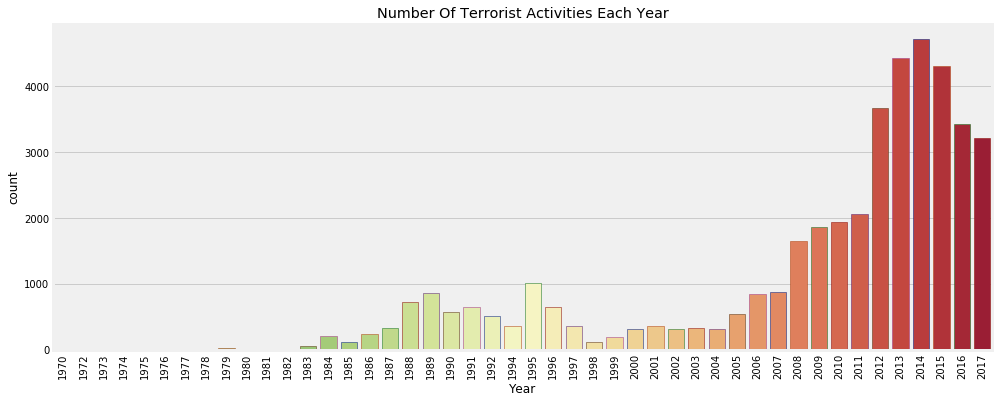

In [18]:
plt.subplots(figsize=(15,6))
sns.countplot('Year',data=df,palette='RdYlGn_r',edgecolor=sns.color_palette('dark',7))
plt.xticks(rotation=90)
plt.title('Number Of Terrorist Activities Each Year')
plt.show()

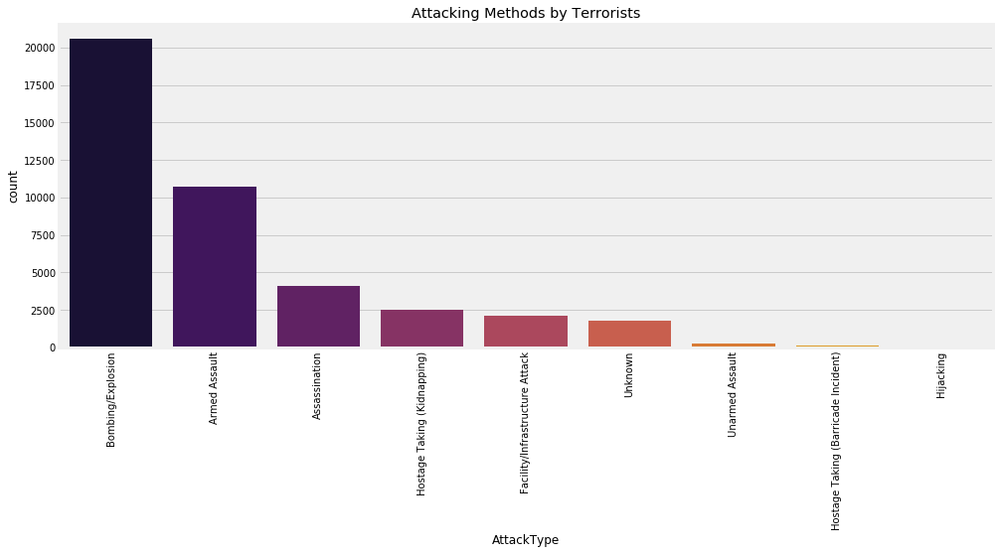

In [19]:
plt.subplots(figsize=(15,6))
sns.countplot('AttackType',data=df,palette='inferno',order=df['AttackType'].value_counts().index)
plt.xticks(rotation=90)
plt.title('Attacking Methods by Terrorists')
plt.show()

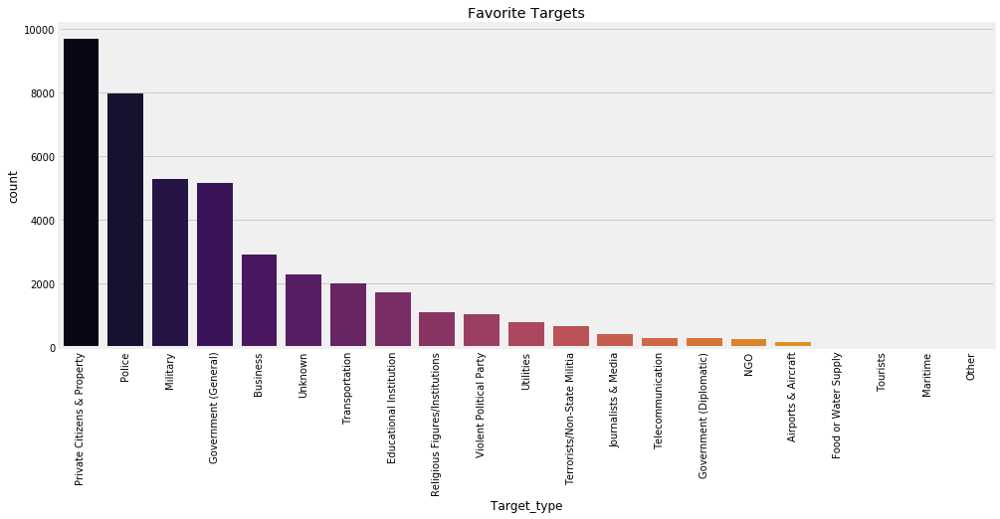

In [20]:
plt.subplots(figsize=(15,6))
sns.countplot(df['Target_type'],palette='inferno',order=df['Target_type'].value_counts().index)
plt.xticks(rotation=90)
plt.title('Favorite Targets')
plt.show()

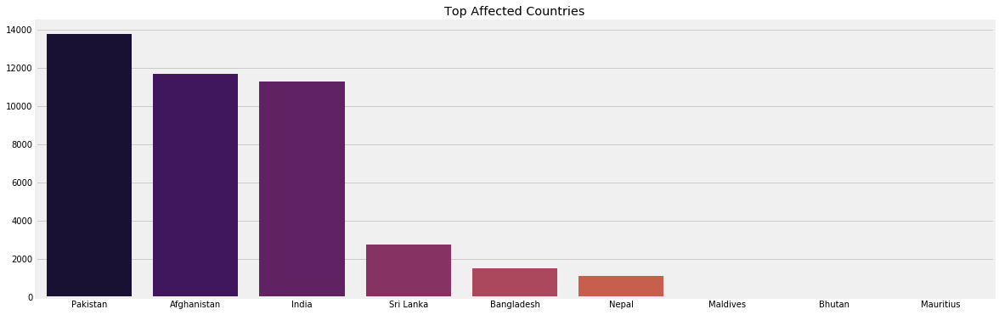

In [21]:
plt.subplots(figsize=(18,6))
sns.barplot(df['Country'].value_counts()[:15].index,df['Country'].value_counts()[:15].values,palette='inferno')
plt.title('Top Affected Countries')
plt.show()

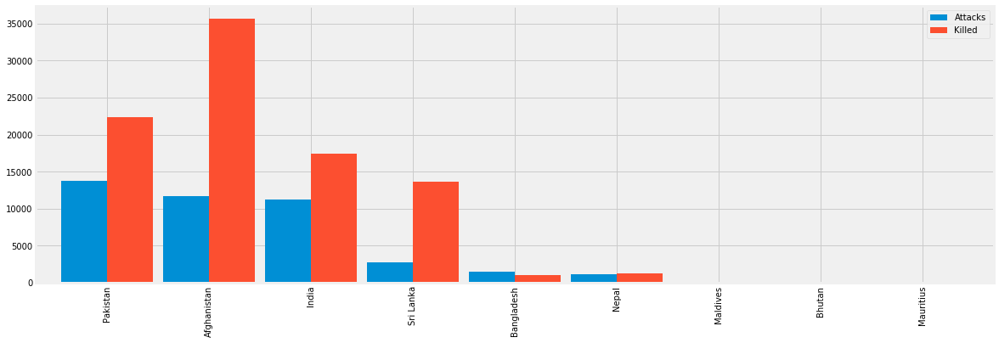

In [22]:
coun_terror=df['Country'].value_counts()[:15].to_frame()
coun_terror.columns=['Attacks']
coun_kill=df.groupby('Country')['Killed'].sum().to_frame()
coun_terror.merge(coun_kill,left_index=True,right_index=True,how='left').plot.bar(width=0.9)
fig=plt.gcf()
fig.set_size_inches(18,6)
plt.show()

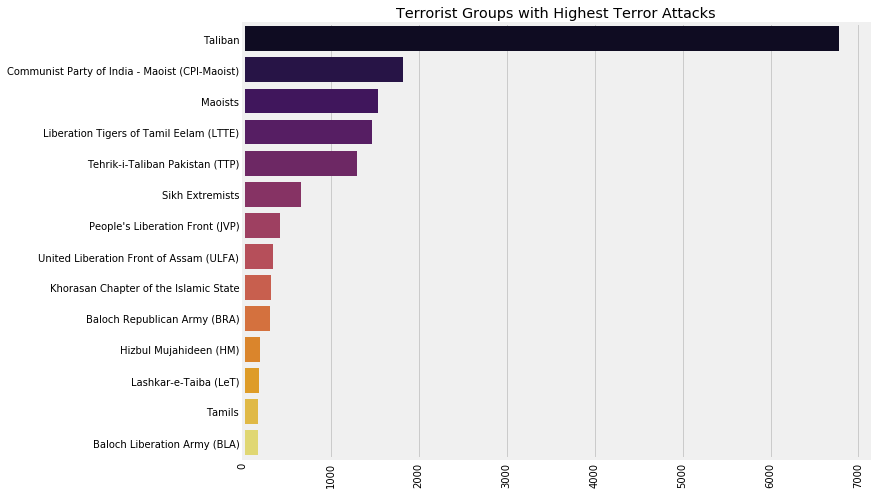

In [23]:
sns.barplot(df['Group'].value_counts()[1:15].values,df['Group'].value_counts()[1:15].index,palette=('inferno'))
plt.xticks(rotation=90)
fig=plt.gcf()
fig.set_size_inches(10,8)
plt.title('Terrorist Groups with Highest Terror Attacks')
plt.show()

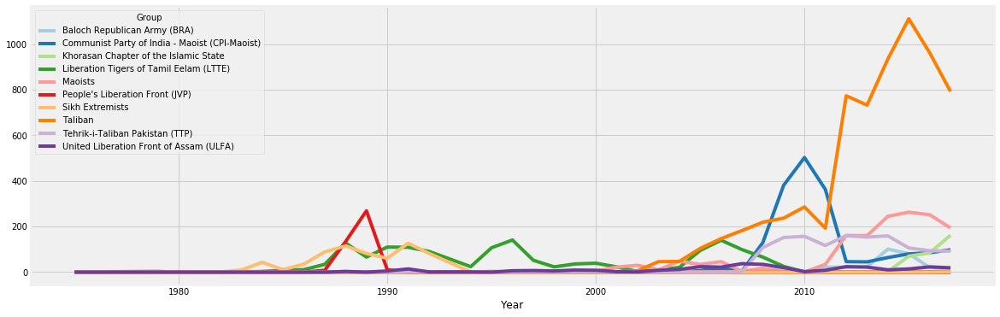

In [24]:
top_groups10=df[df['Group'].isin(df['Group'].value_counts()[1:11].index)]
pd.crosstab(top_groups10.Year,top_groups10.Group).plot(color=sns.color_palette('Paired',10))
fig=plt.gcf()
fig.set_size_inches(18,6)
plt.show()

Text(0, 0.5, 'Attacks')

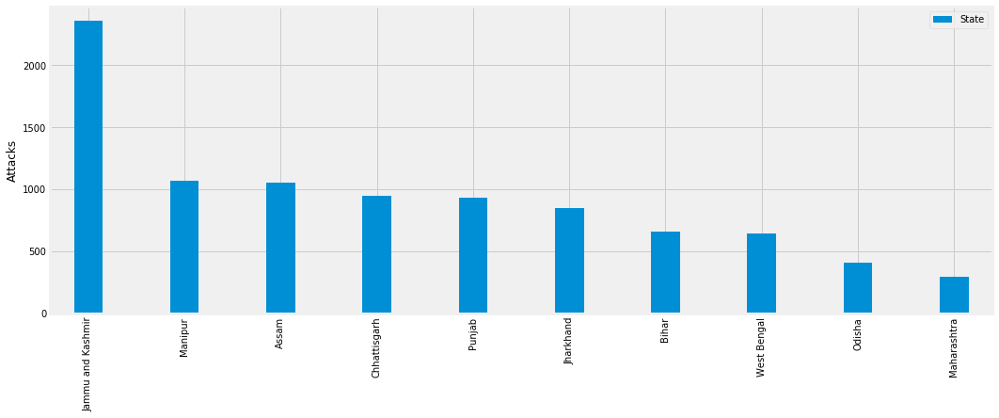

In [25]:
India = df[df['Country']=='India']
India['State'].value_counts()[0:10].to_frame().plot.bar(figsize=(16,6),width=0.3)
plt.ylabel('Attacks')

Text(0, 0.5, 'Attacks')

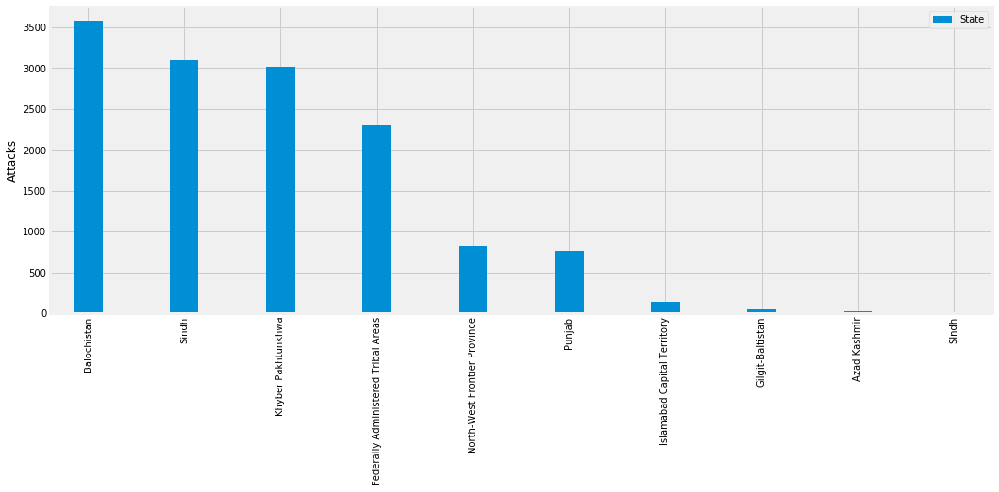

In [26]:
Pakistan = df[df['Country']=='Pakistan']
Pakistan['State'].value_counts()[0:10].to_frame().plot.bar(figsize=(16,6),width=0.3)
plt.ylabel('Attacks')

Text(0, 0.5, 'Attacks')

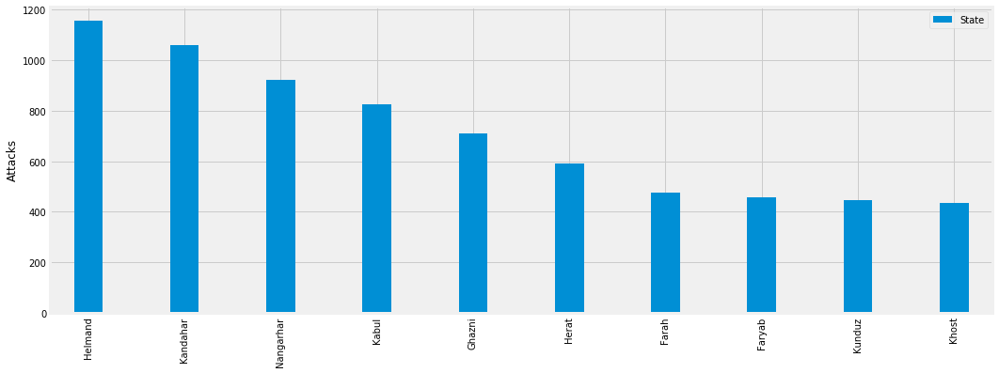

In [27]:
Afghanistan = df[df['Country']=='Afghanistan']
Afghanistan['State'].value_counts()[0:10].to_frame().plot.bar(figsize=(16,6),width=0.3)
plt.ylabel('Attacks')

Text(0, 0.5, 'Attacks')

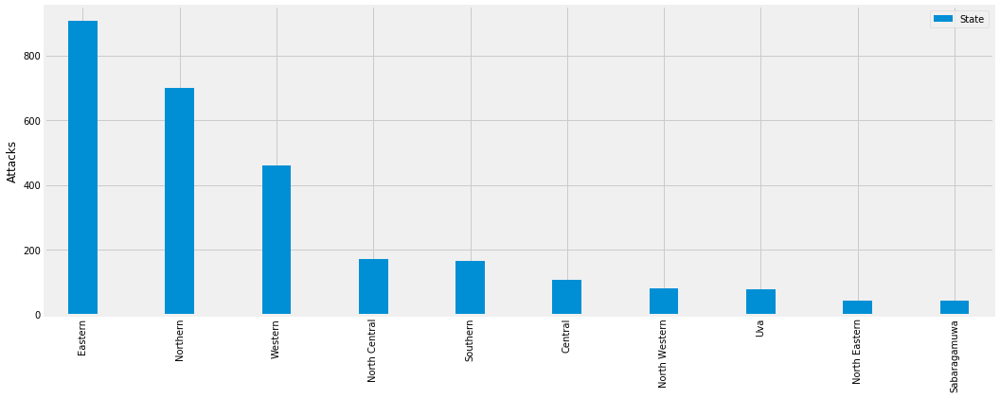

In [28]:
Sri_Lanka = df[df['Country']=='Sri Lanka']
Sri_Lanka['State'].value_counts()[0:10].to_frame().plot.bar(figsize=(16,6),width=0.3)
plt.ylabel('Attacks')

In [29]:
ind = India.groupby('Year')
afg = Afghanistan.groupby('Year')
sri = Sri_Lanka.groupby('Year')
pak = Pakistan.groupby('Year')

i = ind.sum()['Killed']
a = afg.sum()['Killed']
s = sri.sum()['Killed']
p = pak.sum()['Killed']

dfs = pd.DataFrame({'Sri_Lanka':s.values},index=s.index)
dfa = pd.DataFrame({'Afghanistan':a.values},index=a.index)
dfi = pd.DataFrame({'India':i.values},index=i.index)
dfp = pd.DataFrame({'Pakistan':p.values},index=p.index)

result = pd.concat([dfs,dfa,dfi,dfp], axis=1, join_axes=[dfs.index]).fillna(0)
result.iplot(kind='scatter')

In [30]:
 ind.sum()['Killed']

Year
1972       0.0
1975       4.0
1976       0.0
1977       0.0
1979      30.0
1980      16.0
1981      24.0
1982      60.0
1983      59.0
1984     174.0
1985      50.0
1986     306.0
1987     455.0
1988     844.0
1989     763.0
1990     873.0
1991    1049.0
1992    1076.0
1994     360.0
1995     324.0
1996     487.0
1997     651.0
1998     319.0
1999     390.0
2000     565.0
2001     625.0
2002     555.0
2003     429.0
2004     183.0
2005     373.0
2006     649.0
2007     474.0
2008     800.0
2009     745.0
2010     810.0
2011     488.0
2012     262.0
2013     457.0
2014     439.0
2015     381.0
2016     451.0
2017     455.0
Name: Killed, dtype: float64

In [31]:
m=folium.Map(location=[25,80], zoom_start=4)
m

In [32]:
data1 = [go.Scattermapbox(
            lat= df['latitude'] ,
            lon= df['longitude'],
            customdata = df['eventid'],
            mode='markers',
            marker=dict(
                size= 3.5,
                color = 'red',
                opacity = .5,
            ),
          )]
layout = go.Layout(autosize=False,
                   mapbox= dict(accesstoken="pk.eyJ1Ijoic2hhejEzIiwiYSI6ImNqYXA3NjhmeDR4d3Iyd2w5M2phM3E2djQifQ.yyxsAzT94VGYYEEOhxy87w",
                                bearing=0,
                                pitch=50,
                                zoom=4.5,
                                center= dict(
                                         lat=19.5,
                                         lon=80.5),
                                style= "mapbox://styles/shaz13/cjk4wlc1s02bm2smsqd7qtjhs"),
                    width=900,
                    height=600, title = "Terrorist attack locations in South Asia")


In [33]:
fig = dict(data=data1, layout=layout)
iplot(fig)

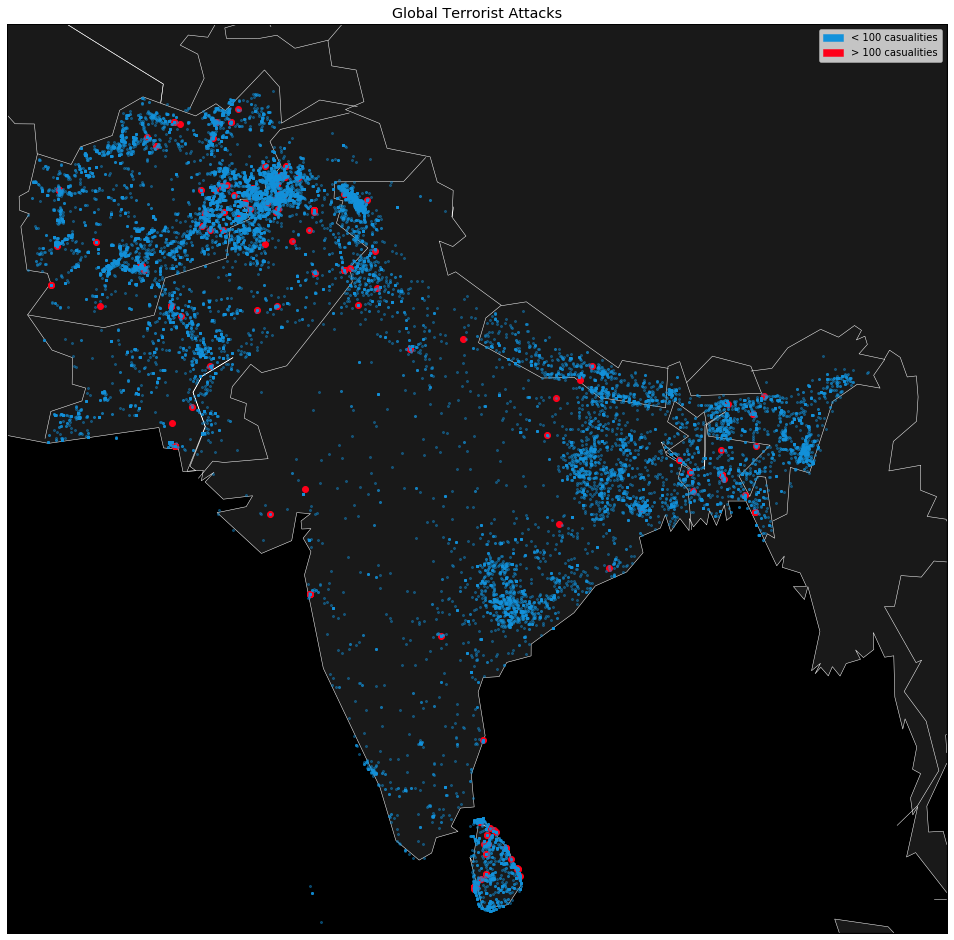

In [58]:
m3 = Basemap(projection='merc',llcrnrlat=5,urcrnrlat=40, llcrnrlon=60,urcrnrlon=100,lat_ts=20,resolution='c',lat_0=True,lat_1=True)
lat_100=list(df[df['casualities']>=100].latitude)
long_100=list(df[df['casualities']>=100].longitude)
x_100,y_100=m3(long_100,lat_100)
m3.plot(x_100, y_100,'go',markersize=6,color = '#ff0019')
lat_=list(df[df['casualities']<100].latitude)
long_=list(df[df['casualities']<100].longitude)
x_,y_=m3(long_,lat_)
m3.plot(x_, y_,'go',markersize=2,color = '#1292db',alpha=0.4)
m3.drawcoastlines(linewidth=0.5, color="w")
m3.fillcontinents(color='#191919',lake_color='#000000') # dark grey land, black lakes
m3.drawmapboundary(fill_color='#000000')                # black background
m3.drawcountries(linewidth=0.5, color="w")              # thin white line for country borders



fig=plt.gcf()
fig.set_size_inches(15,35)
plt.title('Global Terrorist Attacks')
plt.legend(loc='upper right',handles=[mpatches.Patch(color='#1292db', label = "< 100 casualities"),mpatches.Patch(color='#ff0019',label='> 100 casualities')])
plt.show()

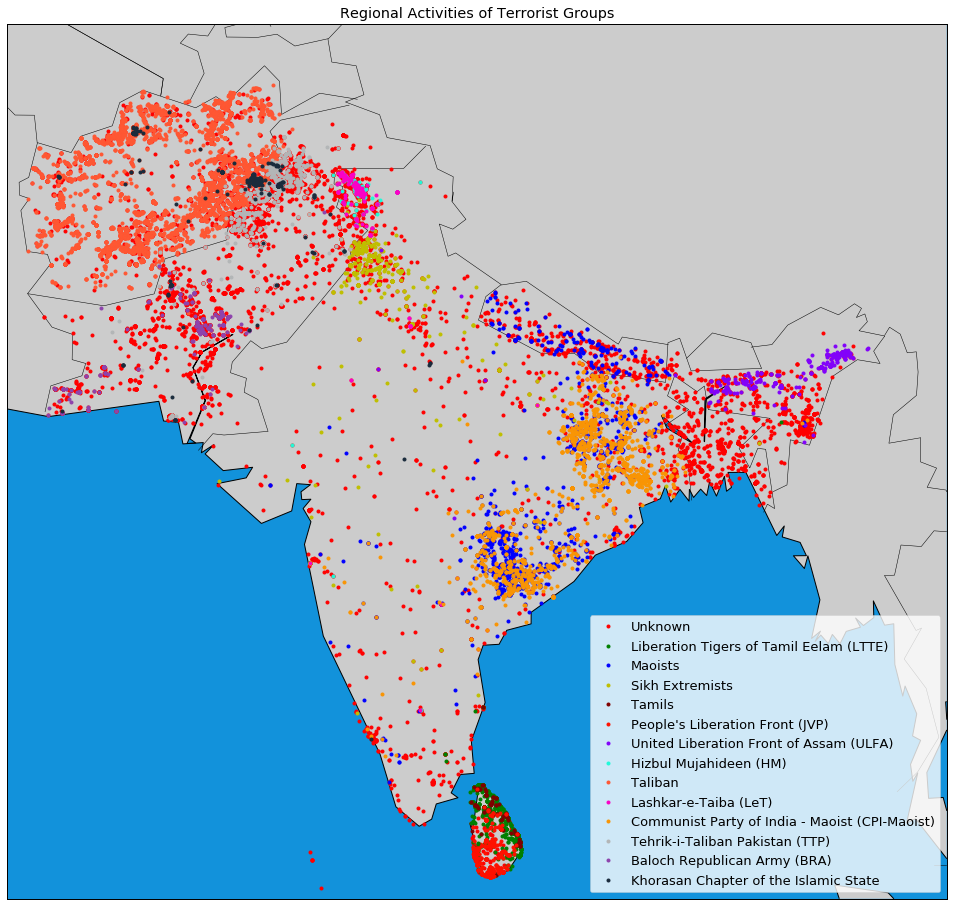

In [98]:
top_groups=df[df['Group'].isin(df['Group'].value_counts()[:14].index)]
m4 = Basemap(projection='mill',llcrnrlat=5,urcrnrlat=40, llcrnrlon=60,urcrnrlon=100,lat_ts=20,resolution='c',lat_0=True,lat_1=True)
m4.drawcoastlines()
m4.drawcountries()
m4.fillcontinents(lake_color='#1292db')
m4.drawmapboundary(fill_color='#1292db')

fig=plt.gcf()
fig.set_size_inches(15,35)
colors=['r','g','b','y','#800000','#ff1100','#8202fa','#20fad9','#ff5733','#fa02c6',"#f99504",'#b3b6b7','#8e44ad','#1a2b3c']
group=list(top_groups['Group'].unique())
def group_point(group,color,label):
    lat_group=list(top_groups[top_groups['Group']==group].latitude)
    long_group=list(top_groups[top_groups['Group']==group].longitude)
    x_group,y_group=m4(long_group,lat_group)
    m4.plot(x_group,y_group,'go',markersize=3,color=j,label=i)
for i,j in zip(group,colors):
    group_point(i,j,i)
legend=plt.legend(loc='lower right',frameon=True,prop={'size':13})
frame=legend.get_frame()
frame.set_facecolor('white')
plt.title('Regional Activities of Terrorist Groups')
plt.show()

MovieWriter imagemagick unavailable. Trying to use pillow instead.



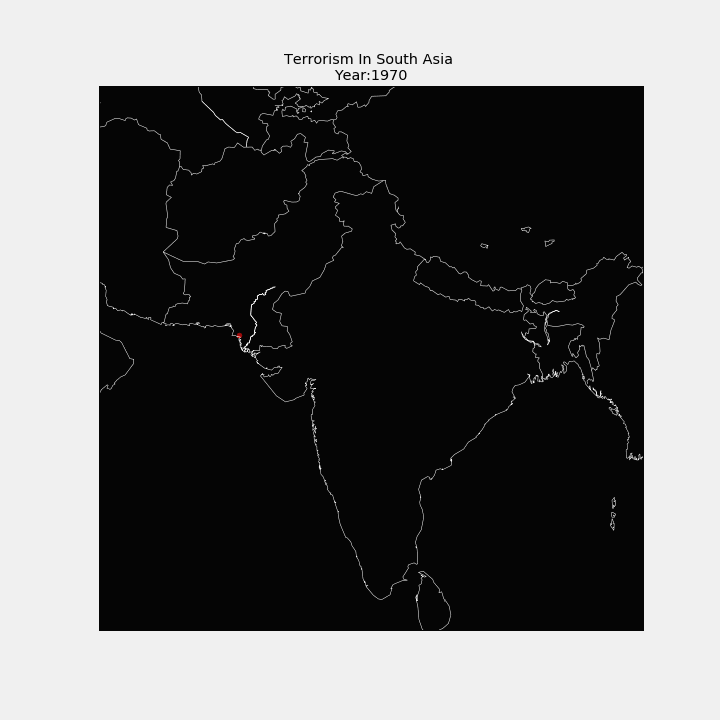

In [92]:
fig = plt.figure(figsize = (10,10))
def animate(Year):
    ax = plt.axes()
    ax.clear()
    ax.set_title('Terrorism In South Asia '+'\n'+'Year:' +str(Year))
    m5 = Basemap(projection='lcc',resolution='l',llcrnrlat=5,urcrnrlat=40, llcrnrlon=60,urcrnrlon=100,lat_0=28,lon_0=77)
    lat_gif=list(df[df['Year']==Year].latitude)
    long_gif=list(df[df['Year']==Year].longitude)
    x_gif,y_gif=m5(long_gif,lat_gif)
    m5.scatter(x_gif, y_gif,s=[killed+wounded for killed,wounded in zip(df[df['Year']==Year].Killed,df[df['Year']==Year].Wounded)],color = 'r')
    m5.drawcoastlines(linewidth=0.5, color="w")
    m5.drawmapboundary(fill_color='#000000')                # black background
    m5.drawcountries(linewidth=0.5, color="w")              # thin white line for country borders
    m5.fillcontinents(color='#191919',lake_color='#000000', zorder = 1,alpha=0.4)
    
ani = animation.FuncAnimation(fig,animate,list(df.Year.unique()), interval = 1500)    
ani.save('animation.gif', writer='imagemagick', fps=1)
plt.close(1)
filename = 'animation.gif'
video = io.open(filename, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<img src="data:image/gif;base64,{0}" type="gif" />'''.format(encoded.decode('ascii')))

In [34]:
data_part =df[['crit1', 'crit2', 'crit3', 'Country']]
data_part.describe()

,crit1,crit2,crit3
count,42260.000000,42260.000000,42260.000000
mean,0.986820,0.991931,0.908164
std,0.114048,0.089466,0.288798
min,0.000000,0.000000,0.000000
25%,1.000000,1.000000,1.000000
50%,1.000000,1.000000,1.000000
75%,1.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000


In [35]:
df['Weapon_type'].value_counts().iplot(kind="bar",color='blue')

In [36]:
df['AttackType'].value_counts().iplot(kind="bar",color='blue')

In [37]:
#Next lets look at a couple historical events
#Since there are too many countries and we will use 5 countries with most attack for each year

traces = []
gtd=df
#Since we don't want a bunch of duplicate series, we will create graphs per country
country_dictY = {} #dictionary for y values
country_dictX = {} #dictionary for xvalues
country_dictTxt = {}
for e in gtd.Year.unique(): #We want to pull up top 5 for each year and add them to dictionaries
    top_5 = gtd.groupby(['Year','Country']).Country.count()[e].sort_values(ascending=False)[0:5]
    for i, country in enumerate(top_5.index):
        if country not in country_dictX:
            country_dictX[country] = []
            country_dictY[country] = []
            country_dictTxt[country] = []
            
        country_dictX[country].append(e)
        country_dictY[country].append(top_5[i])
        text_primer = gtd.loc[(gtd.Country==country) & (gtd.Year == e), 'Group'].value_counts().sort_values(ascending=False).index
        try:
            txt_input = "Three Most Active Terror Groups <br>1) {}<br>2) {}<br>3) {}".format(text_primer[0],text_primer[1],text_primer[2])
        except:
            txt_input = "Most Active Group<br> {}".format(text_primer[0])
        
        country_dictTxt[country].append(txt_input)


for country in country_dictX: #After our dictionaries are loaded, we create instances of graph object and append to list
    #text = "Top 3 Most active Terror Groups <br>1 {}<br>2 {}<br>3 {}".format(country_dictTxt[country].index[0],country_dictTxt[country].index[1],country_dictTxt[country].index[2])
    
    trace = go.Bar(x = country_dictX[country], y=country_dictY[country], name=country, text=country_dictTxt[country])
    traces.append(trace)
line_trace = go.Scatter(x = gtd.groupby('Year').Year.count().index, 
                        y=[total for total in gtd.groupby('Year').Year.count()], 
                           name='Total Terror Attacks for the year', 
                           mode='lines+markers', 
                       yaxis='y2')
traces.append(line_trace)

data = traces 
layout = go.Layout(
    autosize = False, width = 1000, height=750, 
    title = 'Terrorist Attacks by Year in Four most Affected Countries',
    xaxis = dict(
             rangeslider = dict(thickness = 0.1),
             showline = True,
             showgrid = False
         ),
    yaxis = dict(title='Terror Attack by Country',
             showline = True,
             showgrid = False),
    yaxis2 = dict(title = 'Total Terror Attack',
                 showline = True,
                 overlaying = 'y', #Allows for second axis
                 side = 'right'),
    legend=dict(x=1.1, y=1.2),
    annotations = [go.layout.Annotation(
            x = 0.01,
            y = -.1,
            xref = 'paper',
            yref = 'paper',
            text = 'Hover over countries for more details on Groups involved',
            showarrow = False
        )]#If you don't want the leged rubbing to close to the graph...
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='grouped-bar')

In [38]:
print("End")

End
